In [1]:
from IPython.display import Image

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/img_align_celeba -d ./dataset

1) схема устройства GAN
2) dcgan - реализация, обучение, результаты
3) проблемы GAN'ов
4) лоссы для GAN'ов

# Как устроен GAN
![title](\imgs\shema_gan.png)

GAN есть подход для обучения DL моеделей распределению тренировачных данных таком образом, что модель может создавать новые данные из этого распределения.
Подход был разработан Йаном Годфлоу (https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf)

GAN состоит из двух частей:

1) _**G(z)**_: генератор - создает фейковые изобрадения (_**z**_ - вектор латентного простраства взятый из нормального распределения)
2) _**D(x)**_: дискриминатор - отличает фейковые изображения от настоящих (_**x**_ - образец данный взятый либо из распределения настоящих либо сгенерированный)

_**D(G(z))**_ - вероятность, что выход из генератора является образцом из реального распределения данных.

Генератор и дискриминатор играют в _minmax_ игру. Дискриманатор максимизирует вероятность классификации реального образца и фейка (_log**D(x)**_), а генератор минимизирует вероятность, что его выход дискриминатор классифицирует как фейк (_log ( 1 - **D( G(z) )** )_ )

**Лоссфункция GAN**
![title](\imgs\loss.png)

DC GAN - GAN со сверточными слоями.

 Дискриминатор состоит из сверток со страйдами, слоями батчнормализации и активациями LeakyReLU. Вход есть изображение _3х64х64_, а выход вероятность принадлежности к распределению реальных данных.

 Генератор состоит из convolutional-transpose слоев, батчнормализаций, и ReLU активаций. Вход есть латентный вектор _**z**_, полученный из гауссова распределения, а выход изображение _3х64х64_.

In [4]:
from __future__ import print_function
#%matplotlib inline
import random
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [5]:
# Дирректория с изображениями
dataroot = "/content/dataset"

# Количество воркеров для сборки датасета
workers = 2

# Размер батча
batch_size = 64 * 10

# Размер входа сети для изображений. Все изображения ресайзятся к нему
image_size = 128

# Количество каналов цвета
nc = 3

# Размер латентного вектора (размерность латентного пространства)
nz = 100

# Рамер карты признаков для генератора
ndf = 128

# Кол-во эпох
num_epochs = 10

# Лернингрейт
lr = 0.0002

# Параметр для оптимизатора Adam
beta1 = 0.5

# Количество GPU, 0 если считаем на CPU
ngpu = 1

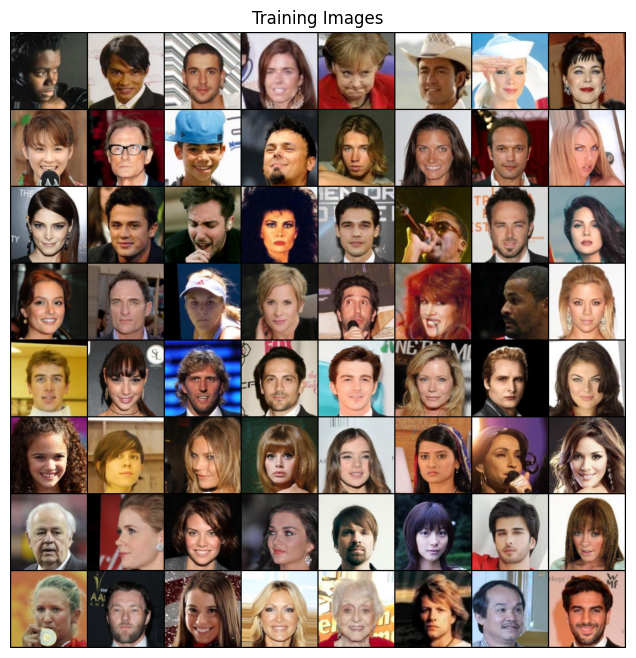

In [18]:
# Для создания датасета используем класс ImageFolder
# Создаем датасет
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Создаем даталоадер
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Выбираем девайс для вычислений
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Нарисуем часть картинок из датасета
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

Генератор отображает латентный вектор _**z**_ в пространство наших данных (из 100 в 3х64х64). Для этого использутся слои convolutional transpose с батчнормализацией и активацией Relu. На выходе тензор пропускается через тангенс и имеет диапазон значений [-1, 1].

![title](\imgs\dcgan.png)

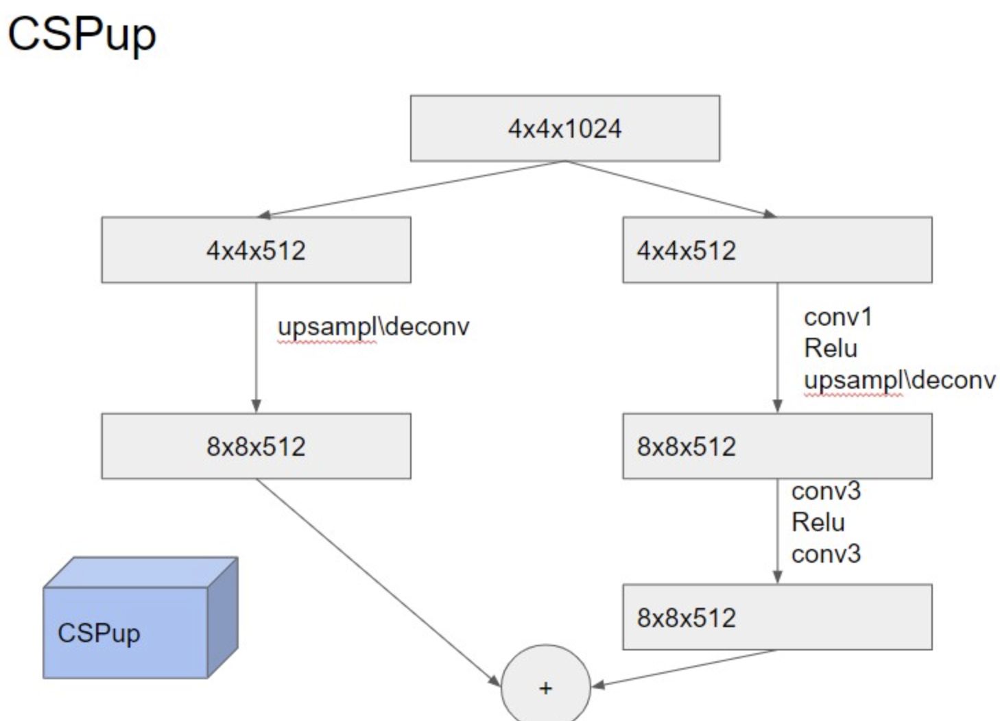


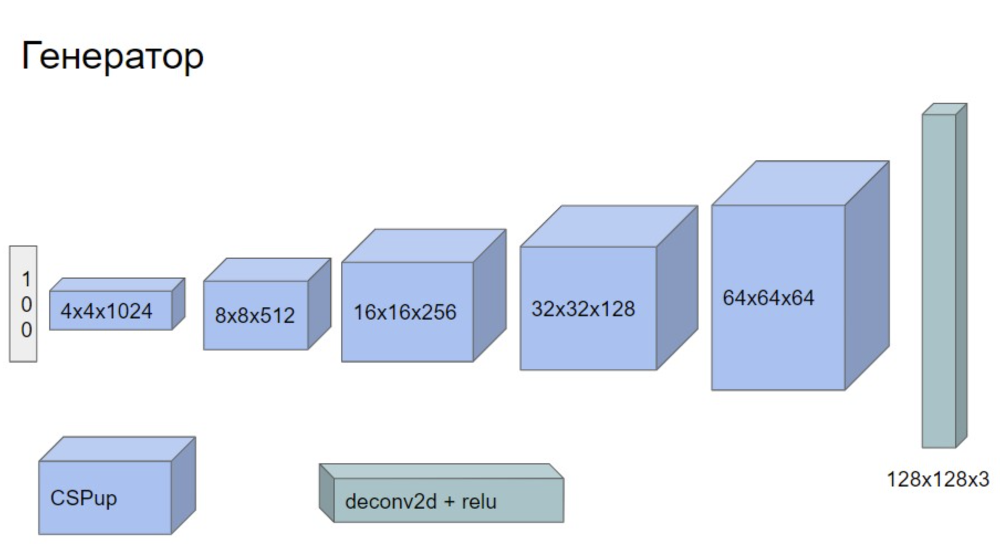


In [7]:
class CSPup(nn.Module):
    def __init__(self, in_size):
        super(CSPup, self).__init__()
        self.in_size = in_size

        self.upsample = nn.ConvTranspose2d(self.in_size, self.in_size, 2, stride=2)

        self.seq1 = nn.Sequential(
            nn.Conv2d(in_channels=self.in_size, out_channels=self.in_size, kernel_size=1),
            nn.BatchNorm2d(self.in_size),
            nn.LeakyReLU(0.2, inplace=True),
            nn.ConvTranspose2d(self.in_size, self.in_size, 2, stride=2)
        )
        self.seq2 = nn.Sequential(
            nn.Conv2d(in_channels=self.in_size, out_channels=self.in_size, kernel_size=3, padding=1),
            nn.BatchNorm2d(self.in_size),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(in_channels=self.in_size, out_channels=self.in_size, kernel_size=3, padding=1)
        )


    def forward(self, x):
        part1, part2 = x[:, :self.in_size], x[:, self.in_size:]

        part1 = self.upsample(part1)

        part2 = self.seq1(part2)
        part2 = self.seq2(part2)

        out = part1 + part2

        return out

In [8]:
# Имплементация генератора
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # вход Z, идет в convolution
            nn.ConvTranspose2d(nz, 1024, 4, 1, 0, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ngf*8) x 4 x 4
            CSPup(512),
            # state size. (ngf*4) x 8 x 8
            CSPup(256),
            # state size. (ngf*2) x 16 x 16
            CSPup(128),
            CSPup(64),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(64, 3, 2, 2, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [19]:
# Инициализируем генератор
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))


print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): CSPup(
      (upsample): ConvTranspose2d(512, 512, kernel_size=(2, 2), stride=(2, 2))
      (seq1): Sequential(
        (0): Conv2d(512, 512, kernel_size=(1, 1), stride=(1, 1))
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
        (3): ConvTranspose2d(512, 512, kernel_size=(2, 2), stride=(2, 2))
      )
      (seq2): Sequential(
        (0): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): LeakyReLU(negative_slope=0.2, inplace=True)
        (3): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1)

Дискриминатор - бинарный классификатор, который  оценивает реальное изображение или сгенерированное. На вход изображение _3x64x64_, обрабатывается серией блоков Conv2d+BatchNorm2d+LeakyReLU, выход проходит через сигмоиду.

In [10]:
# Имплементация дискриминатора

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 16, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [20]:
# инициализируем дискриминатор
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(1024, 2048, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(2048, eps=

In [21]:
# Инициализируем лосс
criterion = nn.BCELoss()

# Создаем батч с рандомным шумом для генерации
fixed_noise = torch.randn(batch_size, nz, 1, 1, device=device)

# Метки для реальных данных и фековых
real_label = 1.
fake_label = 0.

# Устанавливаем оптимизаторы для G и D
optimizerD = optim.Adam(netD.parameters(), lr=lr*0.1, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [16]:
torch.cuda.empty_cache()

In [15]:
from tqdm.notebook import tqdm

Для обучения GAN будем следовать алгоритму I из статьи Годфлоу. На самом деле есть много трюков при обучении GAN'ов, их можно посмотреть здесь https://github.com/soumith/ganhacks. Обучние состоит из 2ух частей:

1) обучение дискриминатора
2) обучение генератора

In [22]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# Для каждой эпохи
for epoch in range(num_epochs):
    # Для каждого батча
    for i, data in tqdm(enumerate(dataloader, 0)):

        ############################
        # (1) Учим дискриминатор: максимизируем log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Для батча
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Прямой прогон батча из реальных картинок D
        output = netD(real_cpu).view(-1)
        # Считаем лосс на всем батче реальных картинок
        errD_real = criterion(output, label)
        # Вычисляем градиенты для дискриминатора
        errD_real.backward()
        D_x = output.mean().item()

        ## Учим на полном фейковом батче
        # Генерируем бат латентных векторов
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Генерируем фековый батч с помощью G
        fake = netG(noise)
        label.fill_(fake_label)
        # Классифицируем фековый батч с помощью D
        output = netD(fake.detach()).view(-1)
        # Вычисляем лосс дискриминатора на фейковом батче
        errD_fake = criterion(output, label)
        # Вычисляем градиент для фейкового батча, он суммируется с предидущим
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Вычисляем ошибку на реальном и фековом батчах
        errD = errD_real + errD_fake
        # Обновляем веса D
        optimizerD.step()

        ############################
        # (2) Учим генератор: максимизируем log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # для генератора фейковые метки есть реальные (0 меняем на 1)
        # Так как мы обновили веса дискриминатора прогоним фековый батч через него еще  раз
        output = netD(fake).view(-1)
        # Вычислим лосс G основываясь на выходе D
        errG = criterion(output, label)
        # Вычислим градиент для G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Обновляем веса G
        optimizerG.step()

        # Выводим статистику обучения
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Сохраним лоссы
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Проверим какие картинки рисует генератор
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        # if i == 1000:
        #   break

        iters += 1

Starting Training Loop...


0it [00:00, ?it/s]

[0/10][0/317]	Loss_D: 1.3144	Loss_G: 2.0708	D(x): 0.5859	D(G(z)): 0.5282 / 0.1334
[0/10][50/317]	Loss_D: 1.8188	Loss_G: 2.3095	D(x): 0.4426	D(G(z)): 0.5389 / 0.1151
[0/10][100/317]	Loss_D: 1.7522	Loss_G: 1.6139	D(x): 0.4510	D(G(z)): 0.5464 / 0.2304
[0/10][150/317]	Loss_D: 1.1897	Loss_G: 1.5020	D(x): 0.6287	D(G(z)): 0.4432 / 0.2758
[0/10][200/317]	Loss_D: 1.5202	Loss_G: 1.8974	D(x): 0.4568	D(G(z)): 0.4736 / 0.1664
[0/10][250/317]	Loss_D: 1.4362	Loss_G: 1.7521	D(x): 0.5341	D(G(z)): 0.4852 / 0.2081
[0/10][300/317]	Loss_D: 1.6359	Loss_G: 1.6353	D(x): 0.4528	D(G(z)): 0.4977 / 0.2200


0it [00:00, ?it/s]

[1/10][0/317]	Loss_D: 1.5584	Loss_G: 1.8616	D(x): 0.4586	D(G(z)): 0.4926 / 0.1808
[1/10][50/317]	Loss_D: 1.5733	Loss_G: 1.1785	D(x): 0.4778	D(G(z)): 0.5261 / 0.3329
[1/10][100/317]	Loss_D: 1.4526	Loss_G: 1.0919	D(x): 0.5193	D(G(z)): 0.5248 / 0.3504
[1/10][150/317]	Loss_D: 1.6298	Loss_G: 1.1444	D(x): 0.4588	D(G(z)): 0.5320 / 0.3394
[1/10][200/317]	Loss_D: 1.4585	Loss_G: 1.0932	D(x): 0.4977	D(G(z)): 0.5019 / 0.3499
[1/10][250/317]	Loss_D: 1.3429	Loss_G: 1.1043	D(x): 0.5298	D(G(z)): 0.4875 / 0.3434
[1/10][300/317]	Loss_D: 1.4876	Loss_G: 1.1931	D(x): 0.4669	D(G(z)): 0.4899 / 0.3158


0it [00:00, ?it/s]

[2/10][0/317]	Loss_D: 1.3864	Loss_G: 1.0122	D(x): 0.5160	D(G(z)): 0.4953 / 0.3751
[2/10][50/317]	Loss_D: 1.4168	Loss_G: 1.0146	D(x): 0.4843	D(G(z)): 0.4724 / 0.3710
[2/10][100/317]	Loss_D: 1.4079	Loss_G: 0.9732	D(x): 0.5339	D(G(z)): 0.5172 / 0.3910
[2/10][150/317]	Loss_D: 1.3241	Loss_G: 0.9912	D(x): 0.5277	D(G(z)): 0.4797 / 0.3810
[2/10][200/317]	Loss_D: 1.5983	Loss_G: 1.0062	D(x): 0.4518	D(G(z)): 0.5247 / 0.3753
[2/10][250/317]	Loss_D: 1.3909	Loss_G: 1.0137	D(x): 0.5095	D(G(z)): 0.4887 / 0.3722
[2/10][300/317]	Loss_D: 1.3043	Loss_G: 1.1705	D(x): 0.5699	D(G(z)): 0.5011 / 0.3201


0it [00:00, ?it/s]

[3/10][0/317]	Loss_D: 1.3796	Loss_G: 1.0227	D(x): 0.4964	D(G(z)): 0.4737 / 0.3722
[3/10][50/317]	Loss_D: 1.4332	Loss_G: 0.9112	D(x): 0.4615	D(G(z)): 0.4625 / 0.4095
[3/10][100/317]	Loss_D: 1.3760	Loss_G: 1.0630	D(x): 0.4738	D(G(z)): 0.4484 / 0.3573
[3/10][150/317]	Loss_D: 1.3298	Loss_G: 1.0541	D(x): 0.5084	D(G(z)): 0.4650 / 0.3602
[3/10][200/317]	Loss_D: 1.3865	Loss_G: 0.9989	D(x): 0.5065	D(G(z)): 0.4926 / 0.3753
[3/10][250/317]	Loss_D: 1.3740	Loss_G: 1.0475	D(x): 0.5167	D(G(z)): 0.4938 / 0.3624
[3/10][300/317]	Loss_D: 1.3688	Loss_G: 1.0415	D(x): 0.5032	D(G(z)): 0.4728 / 0.3642


0it [00:00, ?it/s]

[4/10][0/317]	Loss_D: 1.4080	Loss_G: 1.0472	D(x): 0.5309	D(G(z)): 0.5217 / 0.3624
[4/10][50/317]	Loss_D: 1.5261	Loss_G: 1.0491	D(x): 0.4729	D(G(z)): 0.5209 / 0.3599
[4/10][100/317]	Loss_D: 1.3946	Loss_G: 1.0722	D(x): 0.4721	D(G(z)): 0.4444 / 0.3580
[4/10][150/317]	Loss_D: 1.3888	Loss_G: 1.0076	D(x): 0.4830	D(G(z)): 0.4570 / 0.3756
[4/10][200/317]	Loss_D: 1.3825	Loss_G: 1.0681	D(x): 0.4281	D(G(z)): 0.3883 / 0.3540
[4/10][250/317]	Loss_D: 1.4390	Loss_G: 1.6105	D(x): 0.5446	D(G(z)): 0.5417 / 0.2150
[4/10][300/317]	Loss_D: 1.3540	Loss_G: 1.1570	D(x): 0.4825	D(G(z)): 0.4416 / 0.3256


0it [00:00, ?it/s]

[5/10][0/317]	Loss_D: 1.3356	Loss_G: 1.1735	D(x): 0.5245	D(G(z)): 0.4722 / 0.3249
[5/10][50/317]	Loss_D: 1.1988	Loss_G: 1.1479	D(x): 0.4813	D(G(z)): 0.3388 / 0.3286
[5/10][100/317]	Loss_D: 1.2272	Loss_G: 1.4446	D(x): 0.6601	D(G(z)): 0.5333 / 0.2520
[5/10][150/317]	Loss_D: 1.2967	Loss_G: 1.0603	D(x): 0.4823	D(G(z)): 0.4076 / 0.3597
[5/10][200/317]	Loss_D: 1.2144	Loss_G: 1.1718	D(x): 0.5795	D(G(z)): 0.4690 / 0.3201
[5/10][250/317]	Loss_D: 1.3884	Loss_G: 1.1682	D(x): 0.4541	D(G(z)): 0.4163 / 0.3251
[5/10][300/317]	Loss_D: 1.1955	Loss_G: 1.2458	D(x): 0.5406	D(G(z)): 0.4232 / 0.2991


0it [00:00, ?it/s]

[6/10][0/317]	Loss_D: 1.3532	Loss_G: 1.2805	D(x): 0.5147	D(G(z)): 0.4701 / 0.2912
[6/10][50/317]	Loss_D: 1.3286	Loss_G: 1.7157	D(x): 0.5912	D(G(z)): 0.5256 / 0.1979
[6/10][100/317]	Loss_D: 1.3352	Loss_G: 1.1357	D(x): 0.4321	D(G(z)): 0.3659 / 0.3328
[6/10][150/317]	Loss_D: 1.2179	Loss_G: 1.3658	D(x): 0.6726	D(G(z)): 0.5390 / 0.2706
[6/10][200/317]	Loss_D: 1.3730	Loss_G: 1.0735	D(x): 0.5060	D(G(z)): 0.4765 / 0.3533
[6/10][250/317]	Loss_D: 1.2907	Loss_G: 1.1589	D(x): 0.5267	D(G(z)): 0.4517 / 0.3292
[6/10][300/317]	Loss_D: 1.2884	Loss_G: 1.1114	D(x): 0.4931	D(G(z)): 0.4189 / 0.3411


0it [00:00, ?it/s]

[7/10][0/317]	Loss_D: 1.2888	Loss_G: 1.1946	D(x): 0.5503	D(G(z)): 0.4819 / 0.3145
[7/10][50/317]	Loss_D: 1.3525	Loss_G: 1.3452	D(x): 0.5266	D(G(z)): 0.4821 / 0.2745
[7/10][100/317]	Loss_D: 1.2848	Loss_G: 1.2726	D(x): 0.5484	D(G(z)): 0.4737 / 0.2952
[7/10][150/317]	Loss_D: 1.2799	Loss_G: 1.1936	D(x): 0.5218	D(G(z)): 0.4429 / 0.3201
[7/10][200/317]	Loss_D: 1.3243	Loss_G: 1.2134	D(x): 0.5273	D(G(z)): 0.4745 / 0.3086
[7/10][250/317]	Loss_D: 1.3345	Loss_G: 0.9730	D(x): 0.5132	D(G(z)): 0.4628 / 0.3919
[7/10][300/317]	Loss_D: 1.3111	Loss_G: 1.0838	D(x): 0.5508	D(G(z)): 0.4947 / 0.3479


0it [00:00, ?it/s]

[8/10][0/317]	Loss_D: 1.4488	Loss_G: 0.9703	D(x): 0.4656	D(G(z)): 0.4730 / 0.3878
[8/10][50/317]	Loss_D: 1.3662	Loss_G: 1.2039	D(x): 0.5776	D(G(z)): 0.5424 / 0.3092
[8/10][100/317]	Loss_D: 1.3527	Loss_G: 1.1416	D(x): 0.5054	D(G(z)): 0.4652 / 0.3307
[8/10][150/317]	Loss_D: 1.3422	Loss_G: 0.9149	D(x): 0.4915	D(G(z)): 0.4470 / 0.4115
[8/10][200/317]	Loss_D: 1.3407	Loss_G: 1.1060	D(x): 0.5077	D(G(z)): 0.4645 / 0.3423
[8/10][250/317]	Loss_D: 1.3320	Loss_G: 1.0560	D(x): 0.4839	D(G(z)): 0.4404 / 0.3552
[8/10][300/317]	Loss_D: 1.3340	Loss_G: 1.0508	D(x): 0.5700	D(G(z)): 0.5201 / 0.3616


0it [00:00, ?it/s]

[9/10][0/317]	Loss_D: 1.3035	Loss_G: 0.9959	D(x): 0.5265	D(G(z)): 0.4661 / 0.3804
[9/10][50/317]	Loss_D: 1.2957	Loss_G: 1.0013	D(x): 0.5325	D(G(z)): 0.4660 / 0.3801
[9/10][100/317]	Loss_D: 1.3636	Loss_G: 1.1337	D(x): 0.5599	D(G(z)): 0.5247 / 0.3333
[9/10][150/317]	Loss_D: 1.3597	Loss_G: 1.0543	D(x): 0.5030	D(G(z)): 0.4693 / 0.3594
[9/10][200/317]	Loss_D: 1.3087	Loss_G: 1.2158	D(x): 0.5678	D(G(z)): 0.5069 / 0.3088
[9/10][250/317]	Loss_D: 1.4133	Loss_G: 1.2308	D(x): 0.5733	D(G(z)): 0.5558 / 0.3049
[9/10][300/317]	Loss_D: 1.3067	Loss_G: 1.0078	D(x): 0.5330	D(G(z)): 0.4739 / 0.3738


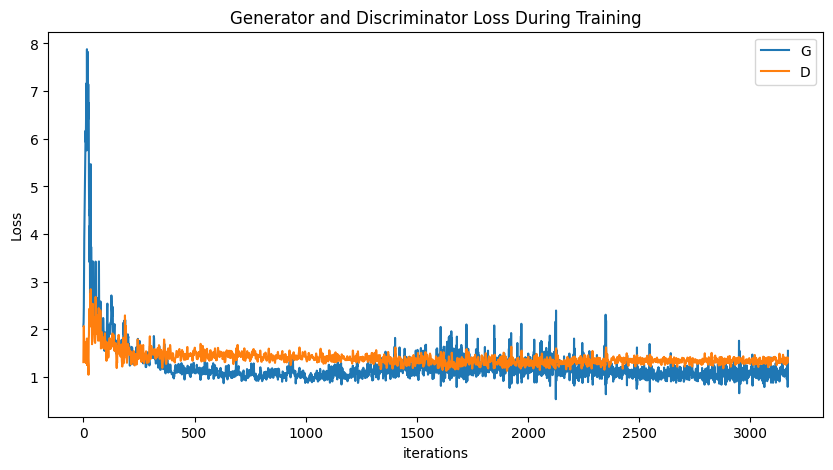

In [25]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

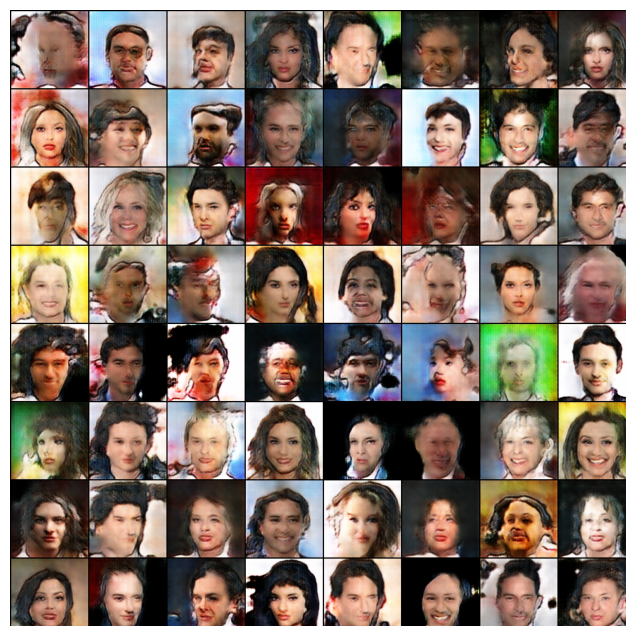

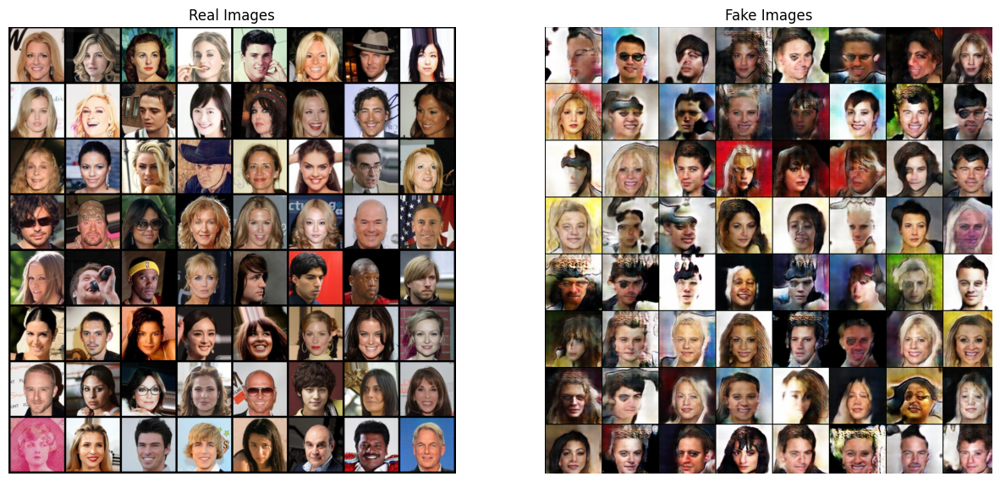

In [33]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i[:, :8 * 128, :8 * 128],(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

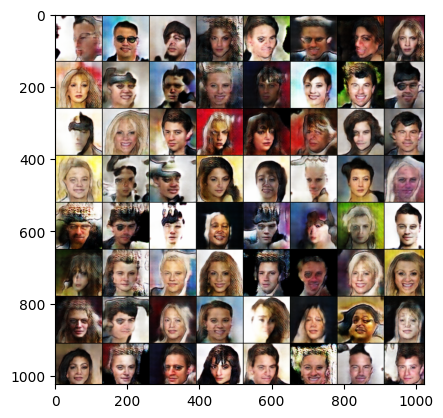

In [35]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1][:, :8 * 128, :8 * 128],(1,2,0)))
plt.show()

In [ ]:
plt.imshow(np.transpose(img_list[-1][:, :8 * 128, :8 * 128], (1, 2, 0)))